In [1]:
import os
import pandas as pd
import numpy as np

# from jupyterthemes import jtplot
# jtplot.style(theme='monokai', context='notebook', ticks=True, grid=False)

import matplotlib.pyplot as plt
plt.rcParams['figure.figsize'] = (15,8)
plt.rcParams['axes.titlesize'] = 24
plt.rcParams['axes.labelsize'] = 20
plt.rcParams['lines.linewidth'] = 3
plt.rcParams['lines.markersize'] = 10
plt.rcParams['xtick.labelsize'] = 16
plt.rcParams['ytick.labelsize'] = 16

import seaborn as sns
sns.set(style="white")
sns.set(style="whitegrid", color_codes=True)

In [2]:
import platform; print(platform.platform())
import sys; print("Python", sys.version)
import numpy; print("NumPy", numpy.__version__)
import scipy; print("SciPy", scipy.__version__)
import sklearn; print("Scikit-Learn", sklearn.__version__)

Windows-10-10.0.19041-SP0
Python 3.8.5 (default, Sep  3 2020, 21:29:08) [MSC v.1916 64 bit (AMD64)]
NumPy 1.19.2
SciPy 1.5.2
Scikit-Learn 0.24.2


# Import Data

In [3]:
# data import
df_usersagg = pd.read_excel('../Data/Zendesk/user_agg.xlsx')
df_checkins = pd.read_csv('../Data/Metabase/checkins.csv').filter(['person_id', 'count checkin'])
df_plans = pd.read_csv('../Data/Metabase/plan_values.csv').rename(columns={'max': 'plan_value'})

In [4]:
# import critical users from Reclame Aqui
df_RA = pd.read_excel('../Data/Critical_Clients/Zendesk - modelo_propensão_Casos_críticos_Reclame_Aqui_06102021_1141.xlsx')
df_RA = df_RA.loc[df_RA['Requester external ID'].notna()]

df_RA['Target'] = 1
df_RA = df_RA.sort_values('Requester external ID', ascending=True).drop_duplicates(subset='Requester external ID')
df_RA = df_RA[['Requester external ID', 'Target']]
df_RA.columns = ['Requester_ID', 'Target']

In [5]:
df_cancel_1 = pd.read_csv('../Data/Metabase/cancelamentos_1.csv')
df_cancel_2 = pd.read_csv('../Data/Metabase/cancelamentos_2.csv')
df_cancel = pd.concat([df_cancel_1, df_cancel_2]).filter(['person_id', 'change_to_type'])

# creatin cancelation flag
df_cancel = (df_cancel.groupby('person_id').count().reset_index().sort_values('change_to_type', ascending=False)
                      .assign(cancel=1))

In [6]:
df = pd.merge(df_usersagg, df_plans, how='left', left_on='Requester_ID', right_on='person_id')
df = pd.merge(df, df_checkins, how='left', left_on='Requester_ID', right_on='person_id')

In [7]:
df = df.filter(['Requester_ID', 'Volume_CHAT', 'Volume_EMAIL', 'Volume_SOCIAL',
           'Tempo_Medio_Chat', 'Tempo_Medio_Email', 'Tempo_Medio_Social',
           'AWT_Chat', '%NFCR', '%Insatisfação(CSAT)', 'CSAT_Rated',
           'plan_value', 'count checkin', 'change_to_type', 'person_id',
           'person_id_x', 'person_id_y'])

# Dataframe Creation

In [8]:
df = pd.merge(df, df_cancel, how='left', left_on='Requester_ID', right_on='person_id')

# Visualization

In [9]:
from pandas_profiling import ProfileReport
prof = ProfileReport(df)
#prof.to_file(output_file='output.html')

In [10]:
prof

<AxesSubplot:>

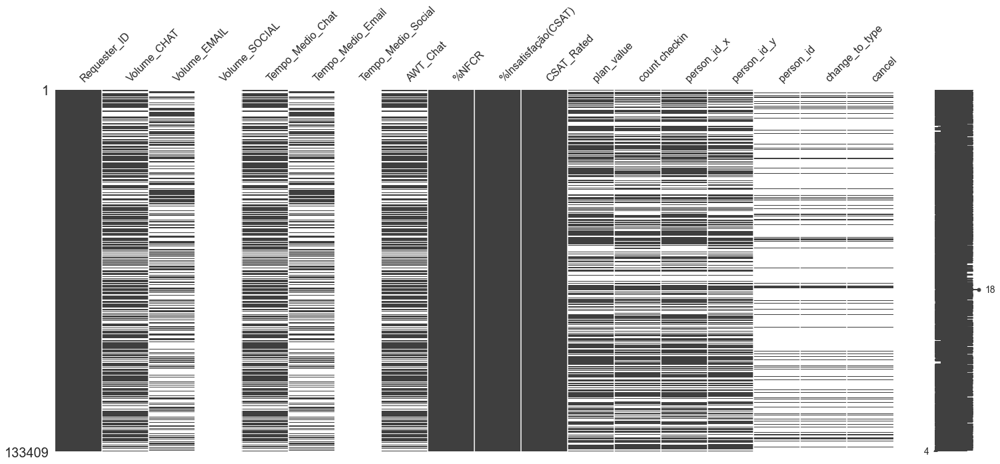

In [11]:
import missingno as msno
%matplotlib inline
msno.matrix(df)

# Data manipulation

## Data Preparation

In [12]:
import warnings
warnings.filterwarnings('ignore')
# Every Volume Chat, E-mail, Social NaN is zero
df.Volume_CHAT.loc[df.Volume_CHAT.isna()] = 0
df.Volume_EMAIL.loc[df.Volume_EMAIL.isna()] = 0
df.Volume_SOCIAL.loc[df.Volume_SOCIAL.isna()] = 0

df.Tempo_Medio_Chat.loc[df.Volume_CHAT==0] = 0
df.Tempo_Medio_Email.loc[df.Volume_EMAIL==0] = 0
df.Tempo_Medio_Social.loc[df.Volume_SOCIAL==0] = 0

df.Tempo_Medio_Chat.loc[df.Tempo_Medio_Chat.isna()] = 0
df.Tempo_Medio_Email.loc[df.Tempo_Medio_Email.isna()] = 0
df.Tempo_Medio_Social.loc[df.Tempo_Medio_Social.isna()] = 0


df.AWT_Chat.loc[df.Volume_CHAT==0] = 0

# Assuming that checkin==NaN is everyone who has not checked in (can be mistake on matebase query)
df['count checkin'].loc[df['count checkin'].isna()] = 0

# Assuming that cancel is NaN is every one who has not tried to cancel (can be mistake on matebase query)
df.cancel.loc[df.cancel.isna()] = 0

df.AWT_Chat.loc[df.AWT_Chat.isna()] = 0

<AxesSubplot:>

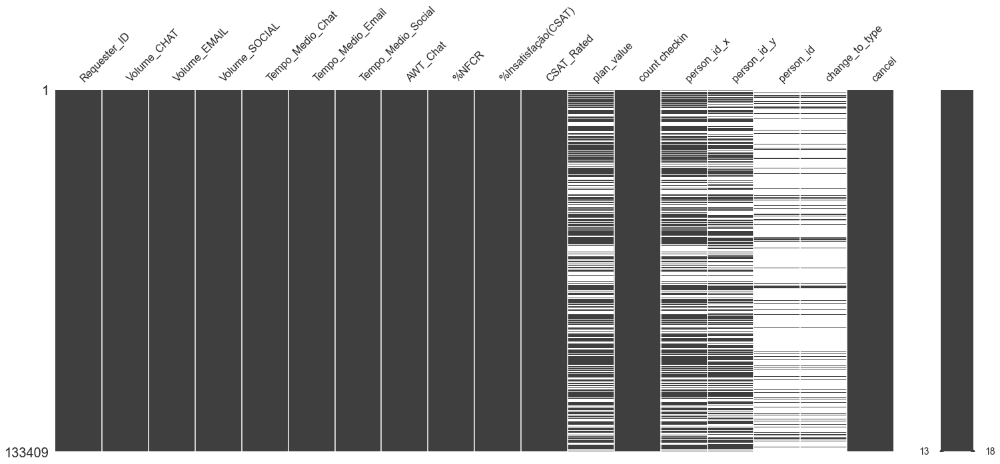

In [13]:
import missingno as msno
%matplotlib inline
msno.matrix(df)

## Data Scaling

In [14]:
from sklearn.preprocessing import MinMaxScaler

columns = ['Volume_CHAT', 'Volume_EMAIL', 'Volume_SOCIAL',
           'Tempo_Medio_Chat', 'Tempo_Medio_Email', 'Tempo_Medio_Social',
           'AWT_Chat', '%NFCR', 'CSAT_Rated', 'plan_value', 
           'count checkin', '%Insatisfação(CSAT)']

# Scale only columns that have values greater than 1
to_scale = [element for element in columns if df[element].max()>1]

In [15]:
mms = MinMaxScaler()
scaled = mms.fit_transform(df[to_scale])
scaled = pd.DataFrame(scaled, columns=to_scale)

# Replace oroginal columns with scaled ones
for col in scaled:
    df[col] = scaled[col]
    

In [16]:
df.head()

,Requester_ID,Volume_CHAT,Volume_EMAIL,Volume_SOCIAL,Tempo_Medio_Chat,Tempo_Medio_Email,Tempo_Medio_Social,AWT_Chat,%NFCR,%Insatisfação(CSAT),CSAT_Rated,plan_value,count checkin,person_id_x,person_id_y,person_id,change_to_type,cancel
0,10000333,0.000000,0.026316,0.0,0.000000,0.143440,0.0,0.000000,0.0,0.0,0.00,NaN,0.000000,NaN,NaN,NaN,NaN,0.0
1,1000043,0.005102,0.000000,0.0,0.101493,0.000000,0.0,0.002523,0.0,0.0,0.05,0.003129,0.044248,1000043.0,1000043.0,NaN,NaN,0.0
2,10000489,0.000000,0.052632,0.0,0.000000,0.017441,0.0,0.000000,0.0,0.0,0.00,NaN,0.000000,NaN,NaN,NaN,NaN,0.0
3,10001430,0.005102,0.000000,0.0,0.169423,0.000000,0.0,0.002270,0.0,0.0,0.00,0.001132,0.203540,10001430.0,10001430.0,NaN,NaN,0.0
4,1000220,0.000000,0.026316,0.0,0.000000,0.021060,0.0,0.000000,0.0,0.0,0.05,0.001132,0.017699,1000220.0,1000220.0,NaN,NaN,0.0


## Target Creation

It has been assumed that all the users who has reached "Reclame Aqui" are our Target -> Critical_Users 

In [17]:
# Join/Merge critical users
df = pd.merge(df, df_RA, how='left')
df.Target.loc[df.Target.isna()] = 0

In [18]:
#df['Target'] = 0
#df.Target.loc[(df['%Insatisfação(CSAT)'] > 0.5) |
#              (df['AWT_Chat'] > 40) |
#              (df['%NFCR'] > 0.33) |
#              (df['total_volume'] >= 7)] = 1             # | (df.cancel==1)

<AxesSubplot:title={'center':'target'}>

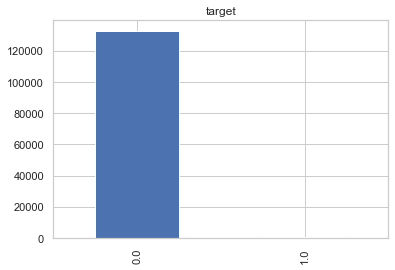

In [19]:
df.Target.value_counts().plot(kind='bar', title='target')

# Vizualization Target in variables

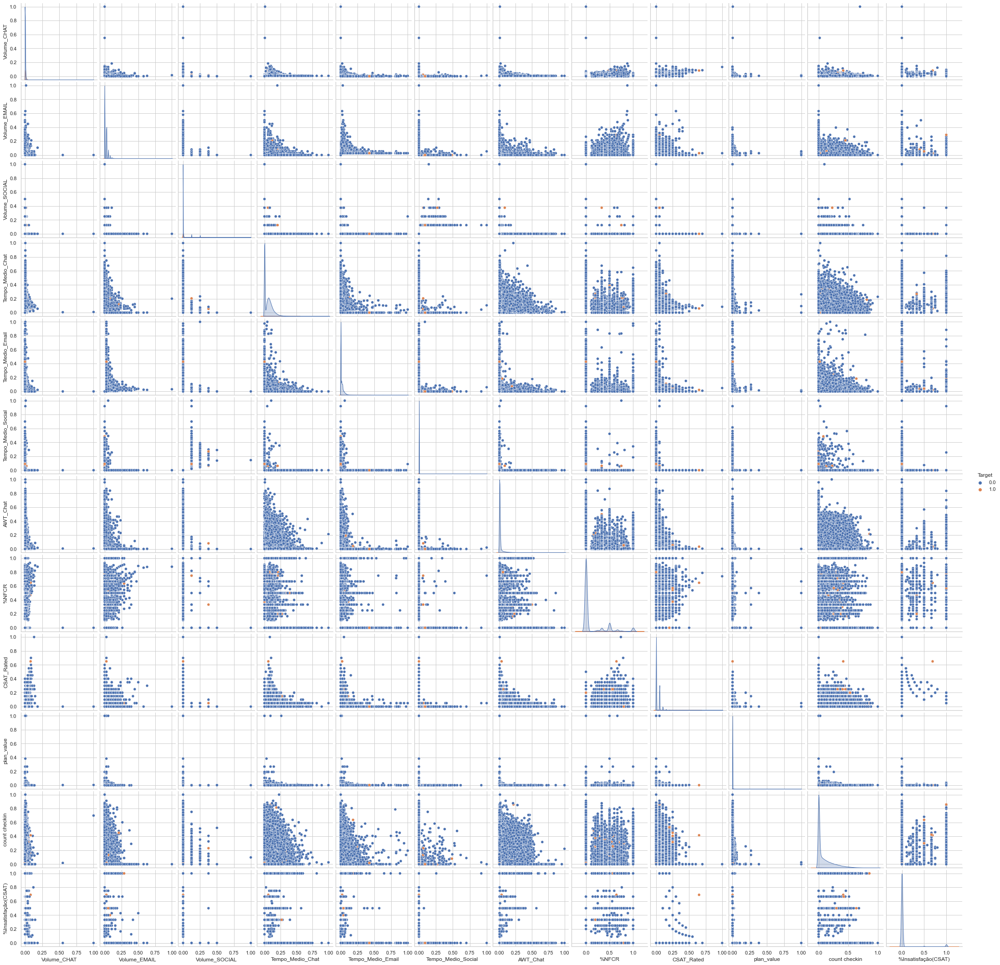

In [20]:
columns = ['Volume_CHAT', 'Volume_EMAIL', 'Volume_SOCIAL',
           'Tempo_Medio_Chat', 'Tempo_Medio_Email', 'Tempo_Medio_Social',
           'AWT_Chat', '%NFCR', 'CSAT_Rated', 'plan_value', 
           'count checkin', '%Insatisfação(CSAT)', 'Target']
sns.pairplot(df.filter(columns), hue='Target')

# Model Creation

## Modeling With SMOTE

### Over-sampling using SMOTE

Synthetic Minority Over-sampling Technique

In [21]:
features = ['Volume_CHAT', 'Volume_EMAIL', 'Volume_SOCIAL',
            'Tempo_Medio_Chat', 'Tempo_Medio_Email', 'Tempo_Medio_Social',
            'AWT_Chat', '%NFCR', '%Insatisfação(CSAT)', 'CSAT_Rated',
            'count checkin', 'cancel', 'total_volume']

In [22]:
y = df.Target
X = df.filter(features)

from imblearn.over_sampling import SMOTE
from sklearn.model_selection import train_test_split


os = SMOTE(random_state=0)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=0)
columns = X_train.columns
os_data_X, os_data_y=os.fit_resample(X_train, y_train)

In [23]:
os_data_X = pd.DataFrame(data=os_data_X, columns=columns )
os_data_y= pd.DataFrame(data=os_data_y, columns=['Target'])
# we can Check the numbers of our data
print("length of oversampled data is ",len(os_data_X))
print("Number of non_critical in oversampled data",len(os_data_y[os_data_y['Target']==0]))
print("Number of critical",len(os_data_y[os_data_y['Target']==1]))
print("Proportion of non_critical data in oversampled data is ",len(os_data_y[os_data_y['Target']==0])/len(os_data_X))
print("Proportion of critical data in oversampled data is ",len(os_data_y[os_data_y['Target']==1])/len(os_data_X))

length of oversampled data is  185868
Number of non_critical in oversampled data 92934
Number of critical 92934
Proportion of non_critical data in oversampled data is  0.5
Proportion of critical data in oversampled data is  0.5


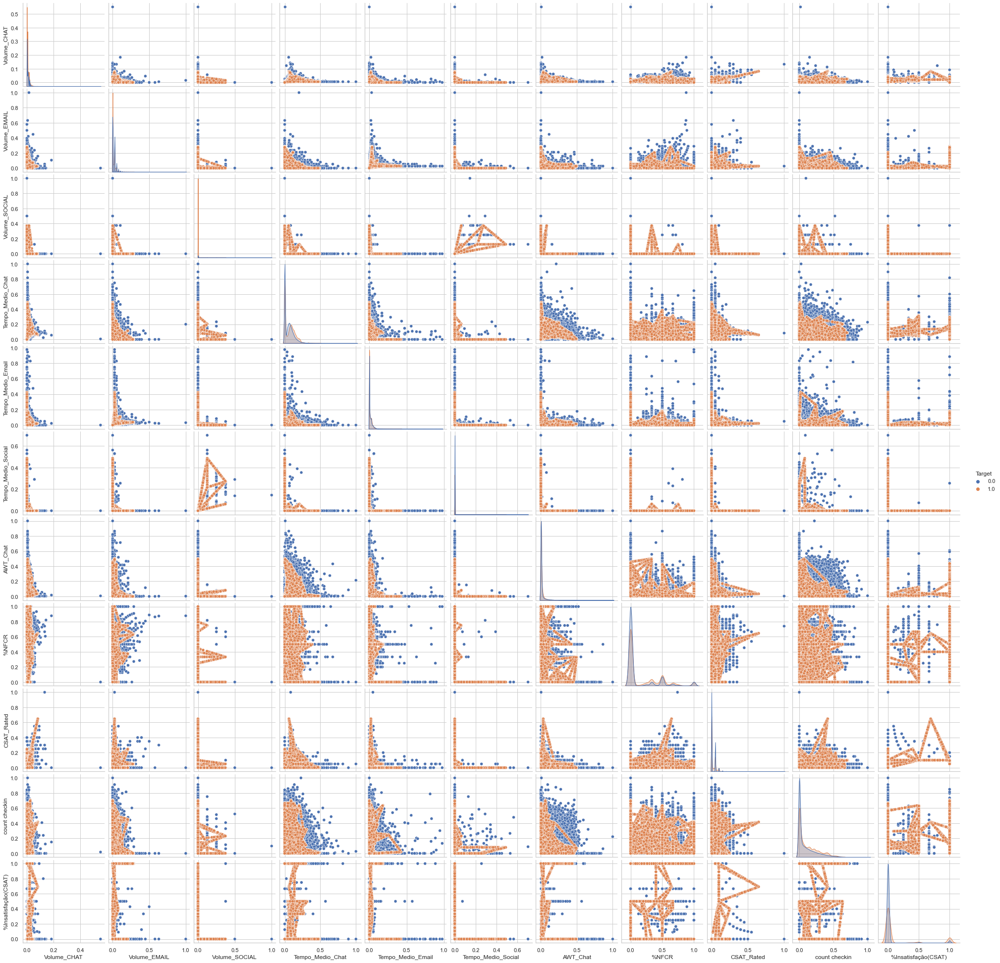

In [24]:
columns = ['Volume_CHAT', 'Volume_EMAIL', 'Volume_SOCIAL',
           'Tempo_Medio_Chat', 'Tempo_Medio_Email', 'Tempo_Medio_Social',
           'AWT_Chat', '%NFCR', 'CSAT_Rated', 'plan_value', 
           'count checkin', '%Insatisfação(CSAT)', 'Target']

result = pd.concat([os_data_X, os_data_y], axis=1)

sns.pairplot(result.filter(columns), hue='Target')

### Logistic Regression (With SMOTE

In [25]:
from sklearn.feature_selection import RFE
from sklearn.linear_model import LogisticRegression
logreg = LogisticRegression()
rfe = RFE(logreg, 20)
rfe = rfe.fit(os_data_X, os_data_y.values.ravel())
#print(rfe.support_)
#print(rfe.ranking_)

In [26]:
X=os_data_X
y=os_data_y

import statsmodels.api as sm
logit_model=sm.Logit(y,X)
result=logit_model.fit()
print(result.summary2())

Optimization terminated successfully.
         Current function value: 0.650009
         Iterations 6
                           Results: Logit
Model:                Logit            Pseudo R-squared: 0.062      
Dependent Variable:   Target           AIC:              241655.7952
Date:                 2021-06-14 14:55 BIC:              241777.3887
No. Observations:     185868           Log-Likelihood:   -1.2082e+05
Df Model:             11               LL-Null:          -1.2883e+05
Df Residuals:         185856           LLR p-value:      0.0000     
Converged:            1.0000           Scale:            1.0000     
No. Iterations:       6.0000                                        
--------------------------------------------------------------------
                     Coef.  Std.Err.    z     P>|z|   [0.025  0.975]
--------------------------------------------------------------------
Volume_CHAT         23.8668   1.0335  23.0937 0.0000 21.8412 25.8923
Volume_EMAIL        -6.4180 

In [27]:
from sklearn.linear_model import LogisticRegression
from sklearn import metrics
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=0)
logreg = LogisticRegression()
logreg.fit(X_train, y_train)

y_pred = logreg.predict(X_test)
print('Accuracy of logistic regression classifier on test set: {:.2f}'.format(logreg.score(X_test, y_test)))

Accuracy of logistic regression classifier on test set: 0.63


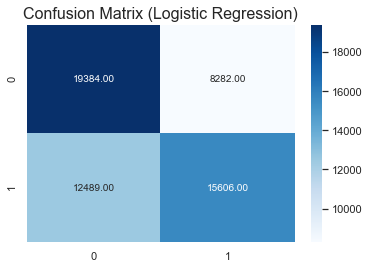

In [28]:
from sklearn.metrics import confusion_matrix

confusion_matrix = confusion_matrix(y_test, y_pred)
plt.title('Confusion Matrix (Logistic Regression)', size=16)
sns.heatmap(confusion_matrix, annot=True, fmt='.2f', cmap='Blues')
plt.show()

In [29]:
from sklearn.metrics import classification_report
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

         0.0       0.61      0.70      0.65     27666
         1.0       0.65      0.56      0.60     28095

    accuracy                           0.63     55761
   macro avg       0.63      0.63      0.63     55761
weighted avg       0.63      0.63      0.63     55761



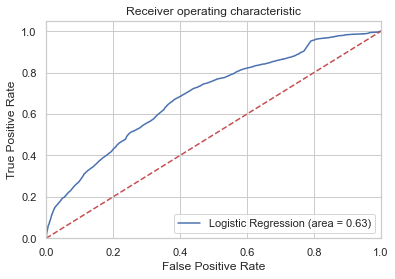

In [30]:
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve
logit_roc_auc = roc_auc_score(y_test, logreg.predict(X_test))
fpr, tpr, thresholds = roc_curve(y_test, logreg.predict_proba(X_test)[:,1])
plt.figure()
plt.plot(fpr, tpr, label='Logistic Regression (area = %0.2f)' % logit_roc_auc)
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic')
plt.legend(loc="lower right")
plt.savefig('Log_ROC')
plt.show()

In [31]:
logreg.predict_proba(X_test)[0]

array([0.35120846, 0.64879154])

he first column is the probability that the entry has the -1 label and the second column is the probability that the entry has the +1 label. Note that classes are ordered as they are in self.classes_.

If you would like to get the predicted probabilities for the positive label only, you can use logistic_model.predict_proba(data)[:,1].

### Dataset with Probabilities

In [32]:
# X_test['Prob'] = logreg.predict_proba(X_test)[:,1]

In [33]:
# X_test

### Random Forest (with SMOTE)

In [34]:
# Fitting Random Forest Classification to the Training set
from sklearn.ensemble import RandomForestClassifier
classifier_rf = RandomForestClassifier(n_estimators = 100, criterion = 'entropy', random_state = 0)
classifier_rf.fit(X_train, y_train)

# Predicting the Test set results
y_pred_rf = classifier_rf.predict(X_test)

# K-foldcross validation
from sklearn.model_selection import cross_val_score
accuracies_rf = cross_val_score(estimator = classifier_rf, X = X_train, y = y_train, cv = 10, n_jobs = -1)
mean_rf = accuracies_rf.mean()
variance_rf = accuracies_rf.std()

In [35]:
from sklearn.metrics import accuracy_score, recall_score

print(f'Accuracy = {accuracy_score(y_test, y_pred_rf):.2f} \n Recall = {recall_score(y_test, y_pred_rf):.2f}')

Accuracy = 0.95 
 Recall = 0.96


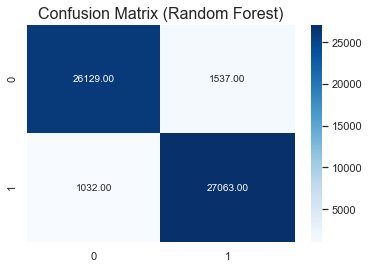

In [36]:
from sklearn.metrics import confusion_matrix

cm_rf = confusion_matrix(y_test, y_pred_rf)
plt.title('Confusion Matrix (Random Forest)', size=16)
sns.heatmap(cm_rf, annot=True, fmt='.2f', cmap='Blues')
plt.show()

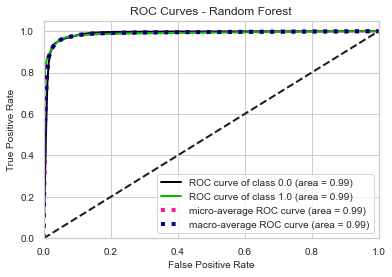

In [37]:
#ROC
import scikitplot as skplt #to make things easy
y_pred_proba = classifier_rf.predict_proba(X_test)
skplt.metrics.plot_roc_curve(y_test, y_pred_proba)
plt.title("ROC Curves - Random Forest")
plt.show()

Text(0.5, 0, 'Random Forest Feature Importance')

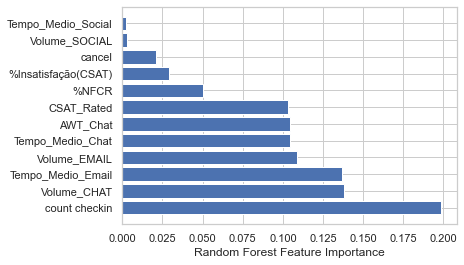

In [38]:
fi = pd.DataFrame({'feature': list(X_train.columns),
                   'importance': classifier_rf.feature_importances_}).\
                    sort_values('importance', ascending = False)

plt.barh(fi.feature,fi.importance)
plt.xlabel("Random Forest Feature Importance")

## Modeling with DownSamples

In [39]:
# Down-sample majority class
from sklearn.utils import resample

df_majority = df[df.Target == 0]
df_minority = df[df.Target == 1]

df_majority_downsampled = resample(df_majority,
                                   replace=False,
                                   n_samples=df_minority.shape[0],
                                   random_state=42)

df_downsampled = pd.concat([df_majority_downsampled, df_minority])

df_downsampled.Target.value_counts()

1.0    679
0.0    679
Name: Target, dtype: int64

### Training and Testing Sets

In [40]:
features = ['Volume_CHAT', 'Volume_EMAIL', 'Volume_SOCIAL',
       'Tempo_Medio_Chat', 'Tempo_Medio_Email', 'Tempo_Medio_Social',
       'AWT_Chat', '%NFCR', '%Insatisfação(CSAT)', 'CSAT_Rated',
       ] #'count checkin', 'cancel', 'total_volume'

In [41]:
from sklearn.model_selection import train_test_split
y = df_downsampled.Target
X = df_downsampled.filter(features)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)

### Logistic Regression

In [42]:
# Feature Scaling
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
X_train_lr = sc.fit_transform(X_train)
X_test_lr = sc.transform(X_test)

In [43]:
# Fitting Logistic Regression to the Training set
from sklearn.linear_model import LogisticRegression
classifier_lr = LogisticRegression(random_state = 0)
classifier_lr.fit(X_train_lr, y_train)

# Predicting the Test set results
y_pred_lr = classifier_lr.predict(X_test_lr)

In [44]:
# Making the Confusion Matrix
from sklearn.metrics import confusion_matrix
cm_lr = confusion_matrix(y_test, y_pred_lr)
tn_lr, fp_lr, fn_lr, tp_lr = confusion_matrix(y_test, y_pred_lr).ravel()
print("Confusion matrix:")
print(cm_lr)

#Accuracy
Accuracy_lr = (tn_lr+tp_lr)/(tp_lr+tn_lr+fp_lr+fn_lr) 
print("Accuracy: {:0.2f}".format(Accuracy_lr))

#precision
Precision_lr = (tp_lr)/(tp_lr+fp_lr) 
print("Precision: {:0.5f}".format(Precision_lr))

#Recall 
Recall_lr = tp_lr/(tp_lr+fn_lr) 
print("Recall: {:0.2f}".format(Recall_lr))

#F1 Score
f1_lr = (2*Precision_lr*Recall_lr)/(Precision_lr + Recall_lr)
print("F1 Score {:0.2f}".format(f1_lr))

Confusion matrix:
[[134  37]
 [100  69]]
Accuracy: 0.60
Precision: 0.65094
Recall: 0.41
F1 Score 0.50


### Decision Tree

In [45]:
from sklearn.datasets import load_iris
from sklearn.tree import DecisionTreeClassifier
from sklearn.tree import export_text

classifier_tree = DecisionTreeClassifier(random_state=0, max_depth=2)
classifier_tree = classifier_tree.fit(X_train, y_train)
# Predicting the Test set results
y_pred_tree = classifier_tree.predict(X_test)

In [46]:
# Making the Confusion Matrix
from sklearn.metrics import confusion_matrix
cm_tree = confusion_matrix(y_test, y_pred_tree)
tn_tree, fp_tree, fn_tree, tp_tree = confusion_matrix(
    y_test, y_pred_tree).ravel()
print("Confusion matrix:")
print(cm_tree)

# Accuracy
Accuracy_tree = (tn_tree+tp_tree)/(tp_tree+tn_tree+fp_tree+fn_tree)
# precision
Precision_tree = (tp_tree)/(tp_tree+fp_tree)
# Recall
Recall_tree = tp_tree/(tp_tree+fn_tree)
# F1 Score
f1_tree = (2*Precision_tree*Recall_tree)/(Precision_tree + Recall_tree)

df_tree = pd.DataFrame(dict([
    ("Dession Tree", [Accuracy_tree, Precision_tree, Recall_tree, f1_tree])]),
    index=["model accuracy", "model precision", "model recall", "model F1 score"])

df_tree

Confusion matrix:
[[123  48]
 [105  64]]


,Dession Tree
model accuracy,0.550000
model precision,0.571429
model recall,0.378698
model F1 score,0.455516


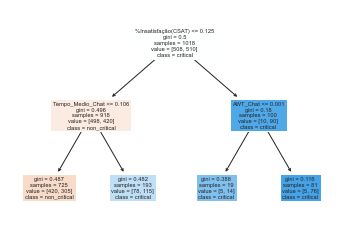

In [47]:
from sklearn import tree
_ = tree.plot_tree(classifier_tree,
                   feature_names=X_train.columns,
                   class_names=['non_critical', 'critical'], # Names of each of the target classes in ascending numerical order.
                   filled=True)

In [48]:
tree.export_graphviz(classifier_tree,
                     out_file="tree.dot",
                     feature_names=X_train.columns,
                     # Names of each of the target classes in ascending numerical order.
                     class_names=['non_critical', 'critical'],
                     filled=True)

!dot - Tpng tree.dot - o tree.png

Error: dot: option -  unrecognized

Usage: dot [-Vv?] [-(GNE)name=val] [-(KTlso)<val>] <dot files>
(additional options for neato)    [-x] [-n<v>]
(additional options for fdp)      [-L(gO)] [-L(nUCT)<val>]
(additional options for memtest)  [-m<v>]
(additional options for config)  [-cv]

 -V          - Print version and exit
 -v          - Enable verbose mode 
 -Gname=val  - Set graph attribute 'name' to 'val'
 -Nname=val  - Set node attribute 'name' to 'val'
 -Ename=val  - Set edge attribute 'name' to 'val'
 -Tv         - Set output format to 'v'
 -Kv         - Set layout engine to 'v' (overrides default based on command name)
 -lv         - Use external library 'v'
 -ofile      - Write output to 'file'
 -O          - Automatically generate an output filename based on the input filename with a .'format' appended. (Causes all -ofile options to be ignored.) 
 -P          - Internally generate a graph of the current plugins. 
 -q[l]       - Set level of message suppression (=1)
 -s[v]     

### Random Forest

In [49]:
# Fitting Random Forest Classification to the Training set
from sklearn.ensemble import RandomForestClassifier
classifier_rf = RandomForestClassifier(n_estimators = 200, criterion = 'entropy', random_state = 0)
classifier_rf.fit(X_train, y_train)

# Predicting the Test set results
y_pred_rf = classifier_rf.predict(X_test)

# K-foldcross validation
from sklearn.model_selection import cross_val_score
accuracies_rf = cross_val_score(estimator = classifier_rf, X = X_train, y = y_train, cv = 10, n_jobs = -1)
mean_rf = accuracies_rf.mean()
variance_rf = accuracies_rf.std()

In [50]:
# Making the Confusion Matrix
from sklearn.metrics import confusion_matrix
cm_rf = confusion_matrix(y_test, y_pred_rf)
tn_rf, fp_rf, fn_rf, tp_rf = confusion_matrix(y_test, y_test).ravel()
print("Confusion matrix:")
print(cm_rf)

#Accuracy
Accuracy_rf = (tn_rf+tp_rf)/(tp_rf+tn_rf+fp_rf+fn_rf) 
#precision
Precision_rf = (tp_rf)/(tp_rf+fp_rf) 
#Recall 
Recall_rf = tp_rf/(tp_rf+fn_rf) 
#F1 Score
f1_rf = (2*Precision_rf*Recall_rf)/(Precision_rf + Recall_rf)

df_rf = pd.DataFrame(dict([
    ("Random Forest", [mean_rf,variance_rf,Accuracy_rf,Precision_rf,Recall_rf,f1_rf])]),
    index=["Mean model accuracy","model variance","model accuracy","model precision","model recall", "model F1 score"])

df_rf

Confusion matrix:
[[ 99  72]
 [ 69 100]]


,Random Forest
Mean model accuracy,0.649437
model variance,0.043908
model accuracy,1.000000
model precision,1.000000
model recall,1.000000
model F1 score,1.000000


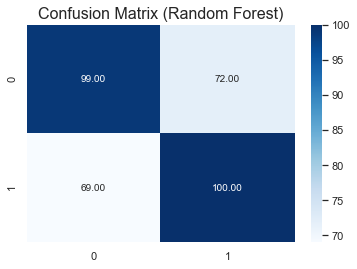

In [51]:
from sklearn.metrics import confusion_matrix

cm_rf = confusion_matrix(y_test, y_pred_rf)
plt.title('Confusion Matrix (Random Forest)', size=16)
sns.heatmap(cm_rf, annot=True, fmt='.2f', cmap='Blues')
plt.show()

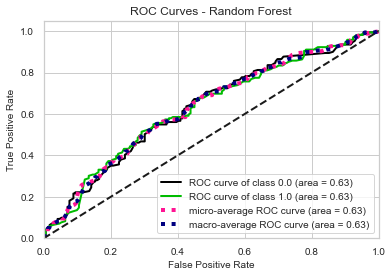

In [52]:
#ROC
import scikitplot as skplt #to make things easy
y_pred_proba = classifier_rf.predict_proba(X_test)
skplt.metrics.plot_roc_curve(y_test, y_pred_proba)
plt.title("ROC Curves - Random Forest")
plt.show()

In [53]:
fi = pd.DataFrame({'feature': list(X_train.columns),
                   'importance': classifier_rf.feature_importances_}).\
                    sort_values('importance', ascending = False)
# Display
fi

,feature,importance
4,Tempo_Medio_Email,0.291967
3,Tempo_Medio_Chat,0.256253
6,AWT_Chat,0.191140
0,Volume_CHAT,0.061646
7,%NFCR,0.057628
8,%Insatisfação(CSAT),0.050753
1,Volume_EMAIL,0.047529
9,CSAT_Rated,0.038900
5,Tempo_Medio_Social,0.002213
2,Volume_SOCIAL,0.001971


Text(0.5, 0, 'Random Forest Feature Importance')

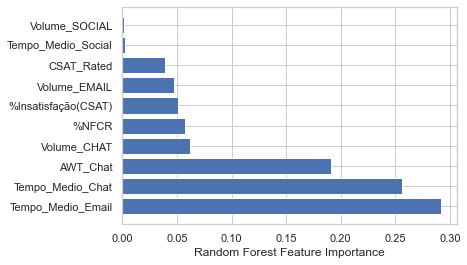

In [54]:
plt.barh(fi.feature,fi.importance)
plt.xlabel("Random Forest Feature Importance")

In [55]:
dict_plans = {'Free Plan': 69.90,
              'Starter': 99.90,
              'Basic I': 119.90,
              'Basic II': 159.90,
              'Silver': 259.90,
              'Silver +':  309.90,
              'Gold': 359.90,
              'Gold +': 559.90,
              'Platinum': 669.90,
              'Platinum': 669.90,
              'Black': 799.90,
              'Black +': 899.90}